In [ ]:
import datetime
import os

import numpy as np
import matplotlib.pyplot as plt 
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.gridspec import GridSpec
import seaborn as sns
import matplotlib as mpl
import pandas as pd
import pickle

import sys
sys.path.append(os.path.abspath('..'))
os.chdir('/user/tlm2160/EZDelay')

from src.tree import TreeModel
from src.climate import BPWClimate
from src.emit_baseline import BPWEmissionBaseline
from src.damage import BPWDamage
from src.tools import import_csv
from src.analysis.output_unpacker import OutputUnpacker
from src.analysis.tree_diagrams import TreeDiagram

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams['figure.figsize'] = 16, 10
params = {'legend.fontsize': 14,
          'legend.frameon': True,
          'figure.figsize': (16, 10),
         'axes.labelsize': 20,
         'axes.titlesize': 20,
         'xtick.labelsize': 18,
         'ytick.labelsize': 18,
         'font.family': 'serif'}
mpl.rcParams.update(params)

from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from scipy.stats import gaussian_kde


# make base filename
today = datetime.datetime.now()
year = str(today.year)
day = str(today.day)
month = str(today.month)

basefile = 'plots/' + ''.join([month, '-', day, '-', year, '-'])

In [2]:
save_fig = False

In [3]:
run_name = "ensemble-cb-ir-l-bs-g"

basepath = os.getcwd()
path = os.path.join(basepath, "data", run_name)

samples = pd.read_csv(os.path.join(path, "samples", "LHC_samples_N3000_DIMS7.csv"))
samples.columns =["RA", "EIS", "tech_chg", "tech_scale", "pref", "bs_premium", "growth"]

conanalysis = pd.read_csv(os.path.join(path, "analysis", f"{run_name}_consolidated_results.csv"))
conanalysis.head()

,sample_index,delay_year,task_id,ra,eis,pref,tech_chg,tech_scale,bs_premium,growth,...,utility_loss,utility_loss_pct,delta_c,delta_c_pct,delta_c_billions,year0_cons_delayed,delta_emission_gton,deadweight_per_ton,carbon_price_delayed,carbon_price_optimal
0,4,5,13,9.847964,0.976726,0.014099,0.630570,2.988180,6476.695594,0.021831,...,0.002895,0.073022,0.010369,1.036892,620.054905,1.0,16.257705,38.139140,0.0,46.036735
1,3,10,11,13.746497,0.849246,0.009660,1.052378,2.619470,13373.058746,0.010456,...,0.004013,0.167896,0.030941,3.094124,1850.266916,1.0,20.647137,89.613726,0.0,70.868196
2,3,5,10,13.746497,0.849246,0.009660,1.052378,2.619470,13373.058746,0.010456,...,0.002782,0.116378,0.021322,2.132206,1275.045943,1.0,20.763153,61.409070,0.0,71.554138
3,2,15,9,12.425921,0.977892,0.007777,0.622541,0.595167,14293.732984,0.017711,...,0.021354,0.334802,0.087720,8.771957,5245.575401,1.0,25.972768,201.964438,0.0,103.079389
4,2,5,7,12.425921,0.977892,0.007777,0.622541,0.595167,14293.732984,0.017711,...,0.009844,0.154337,0.039464,3.946395,2359.919824,1.0,26.023575,90.683922,0.0,103.470589


In [5]:
def get_regression(param, outcome):
    LR = LinearRegression()
    reg = LR.fit(param.reshape(-1, 1), outcome)
    a, b = reg.coef_[0], reg.intercept_
    score = reg.score(param.reshape(-1, 1), outcome)
    return a, b, score

def compute_r2_for_parameters(data, outcome_col, param_cols):
    r2_dict = {}
    for param in param_cols:
        _, _, r2 = get_regression(
            data[param].values,
            data[outcome_col].values
        )
        r2_dict[param] = r2
    return r2_dict

In [6]:
params_of_interest = samples.columns.str.lower().tolist()
delay_fes = ['delay_year']
outcomes = ['m_optimal_period0', 
                        'mitigation_foregone', 
                        'u_optimal', 'u_delayed', 
                        'utility_loss', 
                        'utility_loss_pct', 
                        'delta_c',
                        'delta_c_pct',
                        'delta_c_billions',
                        'delta_emission_gton',
                        'deadweight_per_ton',
                        'carbon_price_optimal',
                        ]

In [7]:
r2_results = {}

for outcome in outcomes:
    r2_dict = compute_r2_for_parameters(conanalysis, outcome, params_of_interest + delay_fes)
    r2_results[outcome] = r2_dict

## Variance Decomposition Analysis

In [8]:
r2_df = pd.DataFrame(r2_results).T
r2_df.columns = r2_df.columns.str.upper()
print("R² Values (Univariate Variance Explained by Each Parameter)")
r2_df

R² Values (Univariate Variance Explained by Each Parameter)


,RA,EIS,TECH_CHG,TECH_SCALE,PREF,BS_PREMIUM,GROWTH,DELAY_YEAR
m_optimal_period0,0.001142,0.369836,0.017019,0.000172,0.523182,0.000570,0.018633,0.000008
mitigation_foregone,0.001142,0.369836,0.017019,0.000172,0.523182,0.000570,0.018633,0.000008
u_optimal,0.000091,0.010882,0.000032,0.000075,0.030427,0.000348,0.013965,0.000039
u_delayed,0.000092,0.010888,0.000033,0.000075,0.030499,0.000348,0.014000,0.000036
utility_loss,0.000001,0.008862,0.000005,0.000087,0.017928,0.000355,0.007962,0.001122
utility_loss_pct,0.007619,0.250321,0.010003,0.001050,0.401043,0.000605,0.009994,0.090922
delta_c,0.000298,0.069361,0.001041,0.000075,0.120902,0.000120,0.000044,0.014226
delta_c_pct,0.000298,0.069361,0.001041,0.000075,0.120902,0.000120,0.000044,0.014226
delta_c_billions,0.000298,0.069361,0.001041,0.000075,0.120902,0.000120,0.000044,0.014226
delta_emission_gton,0.001142,0.369836,0.017019,0.000172,0.523182,0.000570,0.018633,0.000008


In [9]:
total_r2 = r2_df.sum(axis=1)
r2_normalized = r2_df.div(total_r2, axis=0) * 100
print("\nNormalized Variance Contributions (% of Total Explained Variance)")
r2_normalized


Normalized Variance Contributions (% of Total Explained Variance)


,RA,EIS,TECH_CHG,TECH_SCALE,PREF,BS_PREMIUM,GROWTH,DELAY_YEAR
m_optimal_period0,0.122742,39.743306,1.828929,0.018497,56.222072,0.061213,2.002372,0.000869
mitigation_foregone,0.122742,39.743306,1.828929,0.018497,56.222072,0.061213,2.002372,0.000869
u_optimal,0.162248,19.481282,0.058039,0.134797,54.471471,0.623046,24.999793,0.069325
u_delayed,0.164239,19.452803,0.058369,0.134290,54.490993,0.621230,25.012981,0.065095
utility_loss,0.003104,24.397854,0.012460,0.238519,49.360298,0.977487,21.921203,3.089074
utility_loss_pct,0.987543,32.443529,1.296514,0.136139,51.978306,0.078469,1.295277,11.784224
delta_c,0.144825,33.659438,0.505374,0.036309,58.670857,0.058213,0.021496,6.903488
delta_c_pct,0.144825,33.659438,0.505374,0.036309,58.670857,0.058213,0.021496,6.903488
delta_c_billions,0.144825,33.659438,0.505374,0.036309,58.670857,0.058213,0.021496,6.903488
delta_emission_gton,0.122742,39.743306,1.828929,0.018497,56.222072,0.061213,2.002372,0.000869


In [10]:
conanalysis

,sample_index,delay_year,task_id,ra,eis,pref,tech_chg,tech_scale,bs_premium,growth,...,utility_loss,utility_loss_pct,delta_c,delta_c_pct,delta_c_billions,year0_cons_delayed,delta_emission_gton,deadweight_per_ton,carbon_price_delayed,carbon_price_optimal
0,4,5,13,9.847964,0.976726,0.014099,0.630570,2.988180,6476.695594,0.021831,...,0.002895,0.073022,0.010369,1.036892,620.054905,1.0,16.257705,38.139140,0.0,46.036735
1,3,10,11,13.746497,0.849246,0.009660,1.052378,2.619470,13373.058746,0.010456,...,0.004013,0.167896,0.030941,3.094124,1850.266916,1.0,20.647137,89.613726,0.0,70.868196
2,3,5,10,13.746497,0.849246,0.009660,1.052378,2.619470,13373.058746,0.010456,...,0.002782,0.116378,0.021322,2.132206,1275.045943,1.0,20.763153,61.409070,0.0,71.554138
3,2,15,9,12.425921,0.977892,0.007777,0.622541,0.595167,14293.732984,0.017711,...,0.021354,0.334802,0.087720,8.771957,5245.575401,1.0,25.972768,201.964438,0.0,103.079389
4,2,5,7,12.425921,0.977892,0.007777,0.622541,0.595167,14293.732984,0.017711,...,0.009844,0.154337,0.039464,3.946395,2359.919824,1.0,26.023575,90.683922,0.0,103.470589
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8825,2984,5,8953,4.205721,0.579226,0.012660,2.958805,1.230018,17577.883440,0.011931,...,0.000793,0.040962,0.004124,0.412405,246.615628,1.0,7.652240,32.227899,0.0,20.787472
8826,2999,10,8999,14.838712,0.726921,0.008745,2.469095,1.363529,12623.121625,0.010854,...,0.002960,0.118856,0.019919,1.991893,1191.139531,1.0,16.968637,70.196536,0.0,59.317884
8827,2982,15,8949,10.806503,0.662473,0.011610,1.796250,0.914801,7280.566710,0.024348,...,0.001185,0.031399,0.002821,0.282075,168.678980,1.0,7.543473,22.360917,0.0,18.129780
8828,2983,10,8951,5.224393,0.557901,0.006989,2.782472,2.602159,7497.456141,0.017279,...,0.001417,0.039109,0.004108,0.410830,245.673993,1.0,9.171807,26.785780,0.0,25.662910


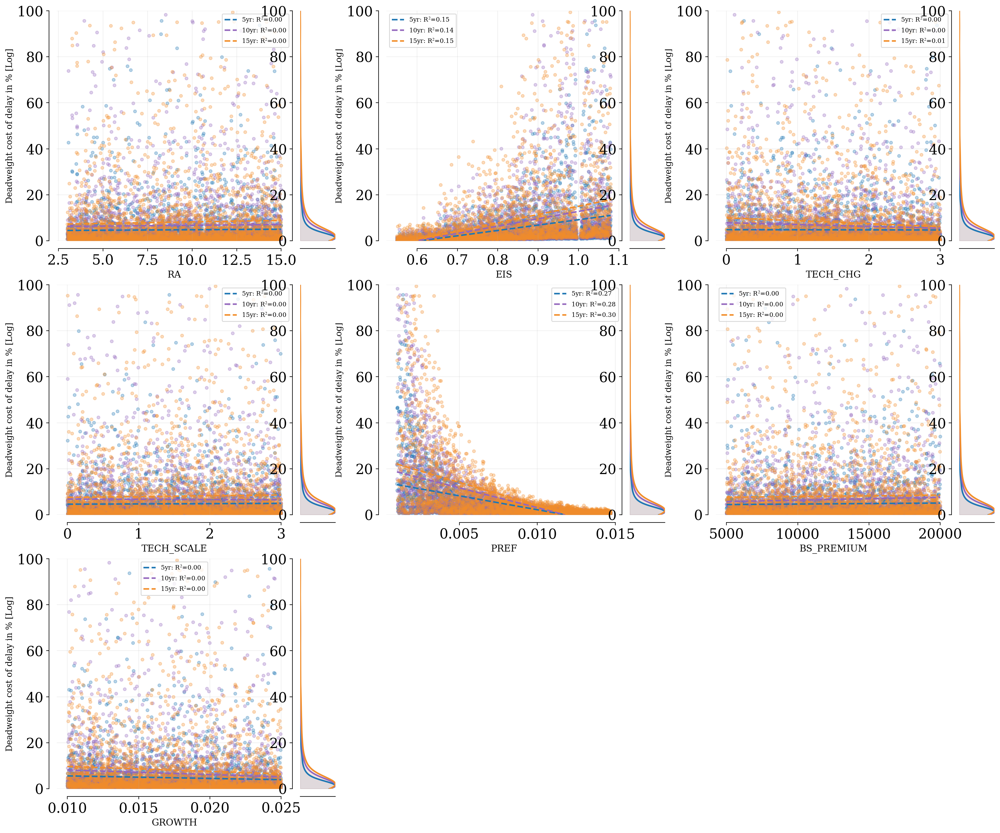

In [ ]:
n_params = len(params_of_interest)
n_cols = 3
n_rows = int(np.ceil(n_params / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 5))
axes = axes.flatten()

dwl_col = 'delta_c_pct'
delay_col = 'delay_year'
unique_delays = sorted(conanalysis[delay_col].unique())

delay_colors = {5: "#1F77B4", 10: "#9467BD", 15: "#F28E2B"}

for idx, param in enumerate(params_of_interest):
    ax = axes[idx]
    # collect y (dwl) values per delay for KDEs
    y_by_delay = {}

    for delay in unique_delays:
        mask = (conanalysis[delay_col] == delay) & (conanalysis[dwl_col] <= 100)
        x = conanalysis.loc[mask, param].values
        y = conanalysis.loc[mask, dwl_col].values
        pos_mask = y > 0
        x_filtered = x[pos_mask]
        y_filtered = y[pos_mask]
        y_by_delay[delay] = y_filtered  # save for KDE

        ax.scatter(x_filtered, y_filtered, alpha=0.3, s=15, 
                   color=delay_colors[delay])

        lr = LinearRegression()
        lr.fit(x.reshape(-1, 1), y)
        x_line = np.linspace(x.min(), x.max(), 100)
        y_line = lr.predict(x_line.reshape(-1, 1))

        pos_line_mask = y_line > 0
        r2 = lr.score(x.reshape(-1, 1), y)

        ax.plot(x_line[pos_line_mask], y_line[pos_line_mask], color=delay_colors[delay], 
                linewidth=2, linestyle='--',
                label=f'{delay}yr: R$^2$={r2:.2f}')

    # main axes formatting
    ax.set_xlabel(param.upper(), fontsize=12)
    ax.set_ylabel('Deadweight cost of delay in % [Log]', fontsize=11)
    ax.legend(fontsize=8, loc='best', framealpha=0.8)
    ax.grid(True, alpha=0.2, which='both')
    ax.set_ylim((0, 100))

    # --- Right-side vertical KDEs (shared y) ---
    divider = make_axes_locatable(ax)
    ax_kde = divider.append_axes("right", size="15%", pad=0.15, sharey=ax)

    # choose y-grid across the visible y-range
    y_min, y_max = ax.get_ylim()
    y_grid = np.linspace(y_min, y_max, 300)

    # scale KDE width relative to the main plot’s x-span
    x_span = np.diff(ax.get_xlim())[0]
    width_scale = 0.20 * x_span  # adjust 0.20 -> wider/narrower KDE panel

    max_width_seen = 0.0
    for delay in unique_delays:
        y_vals = y_by_delay.get(delay, np.array([]))
        if y_vals.size >= 3:  # need a few points for a stable KDE
            kde = gaussian_kde(y_vals)  # bw_method='scott' default
            dens = kde(y_grid)
            # normalize each curve to the same width scale
            if dens.max() > 0:
                dens = dens / dens.max() * width_scale
                max_width_seen = max(max_width_seen, dens.max())
                ax_kde.plot(dens, y_grid, color=delay_colors[delay], lw=2)
                ax_kde.fill_betweenx(y_grid, 0, dens, color=delay_colors[delay], alpha=0.10)
        # if not enough points, skip silently

    # cosmetic tweaks for the KDE axis
    ax_kde.set_xlim(0, max(1e-9, max_width_seen))
    ax_kde.set_xticks([])
    ax_kde.set_xlabel('')
    ax_kde.grid(False)
    for spine in ['top', 'right', 'bottom']:
        ax_kde.spines[spine].set_visible(False)

# remove any unused subplots
for idx in range(n_params, len(axes)):
    fig.delaxes(axes[idx])

plt.tight_layout()
sns.despine(trim=True, offset=10)
if save_fig:
    plt.savefig(basefile + 'dwl_vs_all_params_by_delay_log.png', dpi=300, bbox_inches='tight')
plt.show()


/tmp/ipykernel_26525/249430614.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


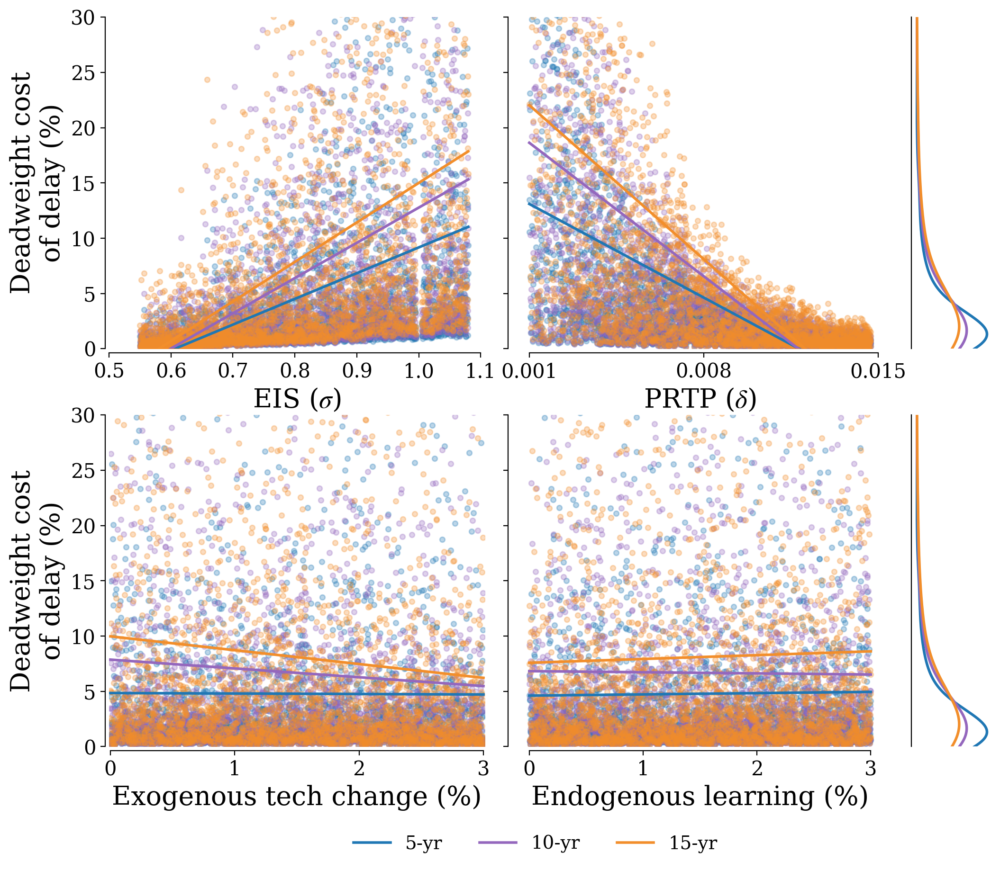

In [ ]:
params = {
    'legend.fontsize': 14,
    'legend.frameon': True,
    'figure.figsize': (18, 10),
    'axes.labelsize': 20,
    'axes.titlesize': 20,
    'xtick.labelsize': 15,
    'ytick.labelsize': 15,
    'font.family': 'serif'
}
mpl.rcParams.update(params)

x_vars = ['eis', 'pref', 'tech_chg', 'tech_scale']
x_labels = {
    'eis': r"EIS ($\sigma$)",
    'pref': r"PRTP ($\delta$)",
    'tech_chg': "Exogenous tech change (%)",
    'tech_scale': "Endogenous learning (%)"
}
y_col = 'delta_c_pct'
delay_col = 'delay_year'

unique_delays = sorted(conanalysis[delay_col].unique())
delay_colors = {5: "#1F77B4", 10: "#9467BD", 15: "#F28E2B"}

y_cutoff = 30

df = conanalysis.loc[
    (conanalysis[y_col] > 0) & (conanalysis[y_col] <= 100)
].copy()


fig, ax_arr = plt.subplots(
    2, 3, figsize=(12, 10),
    gridspec_kw={'width_ratios': [1, 1, 0.2], 'wspace': 0.1, 'hspace': 0.20}
)

scatter_axes = [ax_arr[0, 0], ax_arr[0, 1], ax_arr[1, 0], ax_arr[1, 1]]
kde_axes = [ax_arr[0, 2], ax_arr[1, 2]]

for ax, x_col in zip(scatter_axes, x_vars):
    for delay in unique_delays:
        d = df[df[delay_col] == delay]
        x = d[x_col].values
        y = d[y_col].values

        ax.scatter(x, y, s=15, alpha=0.3, color=delay_colors.get(delay, "#333333"),
                   label=f"{delay}-yr")

        if len(x) >= 2 and np.isfinite(x).all() and np.isfinite(y).all():
            lr = LinearRegression().fit(x.reshape(-1, 1), y)
            x_line = np.linspace(np.nanmin(x), np.nanmax(x), 100)
            y_line = lr.predict(x_line.reshape(-1, 1))
            r2 = lr.score(x.reshape(-1, 1), y)
            ax.plot(x_line, y_line, color=delay_colors.get(delay, "#333333"), lw=2,
                    label=f'{delay}-yr')

    ax.set_xlabel(x_labels.get(x_col, x_col))
    ax.set_ylim(0, y_cutoff)

scatter_axes[0].set_ylabel('Deadweight cost\nof delay (%)', fontsize=20)
scatter_axes[2].set_ylabel('Deadweight cost\nof delay (%)', fontsize=20)
for ax in [scatter_axes[1], scatter_axes[3]]:
    ax.set_ylabel('')
    ax.tick_params(axis='y', labelleft=False)

if 'eis' in x_vars:
    i = x_vars.index('eis')
    scatter_axes[i].set_xticks(np.arange(0.5, 1.1, 0.1))

if 'pref' in x_vars:
    i = x_vars.index('pref')
    scatter_axes[i].set_xticks([0.001, 0.008, 0.015])

if 'tech_chg' in x_vars:
    i = x_vars.index('tech_chg')
    scatter_axes[i].set_xlim((-0.01, 3.01))

if 'tech_scale' in x_vars:
    i = x_vars.index('tech_scale')
handles, labels = scatter_axes[0].get_legend_handles_labels()
by_label = dict(zip(labels[1::2], handles[1::2]))

for row_idx, ax_kde in enumerate(kde_axes):
    left_ax = scatter_axes[row_idx * 2]
    y_min, y_max = left_ax.get_ylim()
    bins = np.linspace(y_min, y_max, 50)
    y_grid = np.linspace(y_min, y_max, 400)
    xmax_seen = 0.0

    for delay in unique_delays:
        d = df[df[delay_col] == delay]
        y_vals = d[y_col].values
        if len(y_vals) < 6:
            continue

        kde = gaussian_kde(y_vals)
        dens = kde(y_grid)
        ax_kde.plot(dens, y_grid, color=delay_colors.get(delay, "#333333"), lw=2)
        xmax_seen = max(xmax_seen, np.nanmax(dens))

    ax_kde.set_xlim(0, xmax_seen * 1.05 if xmax_seen > 0 else 1)
    ax_kde.set_ylim((0, y_cutoff))
    ax_kde.set_xticks([])
    ax_kde.set_yticks([])
    ax_kde.set_xlabel('')
    ax_kde.set_ylabel('')
    ax_kde.grid(False)
    for spine in ['top', 'right', 'bottom']:
        ax_kde.spines[spine].set_visible(False)

fig.legend(
    by_label.values(), by_label.keys(),
    loc='lower center',
    bbox_to_anchor=(0.5, -0.02),
    ncol=len(unique_delays),
    frameon=False,
    fontsize=14
)

plt.tight_layout()
sns.despine(trim=True, offset=3)
for row_idx, ax_kde in enumerate(kde_axes):
    for spine in ['top', 'right', 'bottom']:
        ax_kde.spines[spine].set_visible(False)
plt.savefig(basefile + 'dwl_vs_4params_by_delay.png', dpi=300, bbox_inches='tight')
plt.show()


/tmp/ipykernel_38549/2015060878.py:69: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


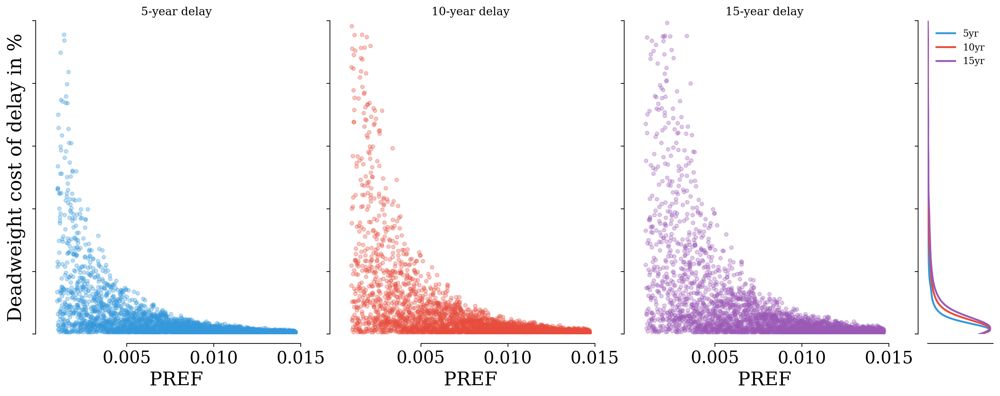

In [ ]:
x_col = 'pref'
y_col = 'delta_c_pct'
delay_col = 'delay_year'

unique_delays = sorted(conanalysis[delay_col].unique())
delay_colors = {5: '#3498db', 10: '#e74c3c', 15: '#9b59b6'}

df = conanalysis.loc[(conanalysis[y_col] > 0) & (conanalysis[y_col] <= 100)].copy()

fig = plt.figure(figsize=(18, 6))
gs = GridSpec(nrows=1, ncols=4, width_ratios=[1, 1, 1, 0.25], wspace=0.15)

axes_main = [fig.add_subplot(gs[0, i]) for i in range(3)]
ax_right = fig.add_subplot(gs[0, 3], sharey=axes_main[0])

for ax, delay in zip(axes_main, unique_delays[:3]):
    d = df[df[delay_col] == delay]
    ax.scatter(
        d[x_col], d[y_col],
        color=delay_colors[delay],
        alpha=0.3, s=15, label=f"{delay}-year delay"
    )

    ax.set_title(f"{delay}-year delay", fontsize=12)
    #ax.set_xlim((0.5, 1.1))
    #ax.set_xticks(np.arange(0.5, 1.1, 0.3))
    ax.set_xlabel(x_col.upper(), fontsize=20)
    ax.set_ylim(0, 100)
    if delay == 5:
        ax.set_ylabel('Deadweight cost of delay in %', fontsize=20)
    else:
        ax.set_yticklabels([])

y_min, y_max = 0, 100
y_grid = np.linspace(y_min, y_max, 400)

for delay in unique_delays[:3]:
    d = df[df[delay_col] == delay]
    y_vals = d[y_col].values
    if len(y_vals) > 5:
        kde = gaussian_kde(y_vals)
        dens = kde(y_grid)
        dens = dens / dens.max() 
        ax_right.plot(dens, y_grid, color=delay_colors[delay], lw=2, label=f"{delay}yr")
        #ax_right.fill_betweenx(y_grid, 0, dens, color=delay_colors[delay], alpha=0.2)

ax_right.set_xlim(0, 1.05)
ax_right.set_ylim(0, 100)
ax_right.set_xticks([])
ax_right.set_xlabel('')
ax_right.legend(fontsize=10, loc='upper right', frameon=False)
ax_right.grid(False)
ax_right.set_yticklabels([])

for spine in ['top', 'right', 'bottom']:
    ax_right.spines[spine].set_visible(False)

plt.tight_layout()
sns.despine(trim=True, offset=10)
plt.show()


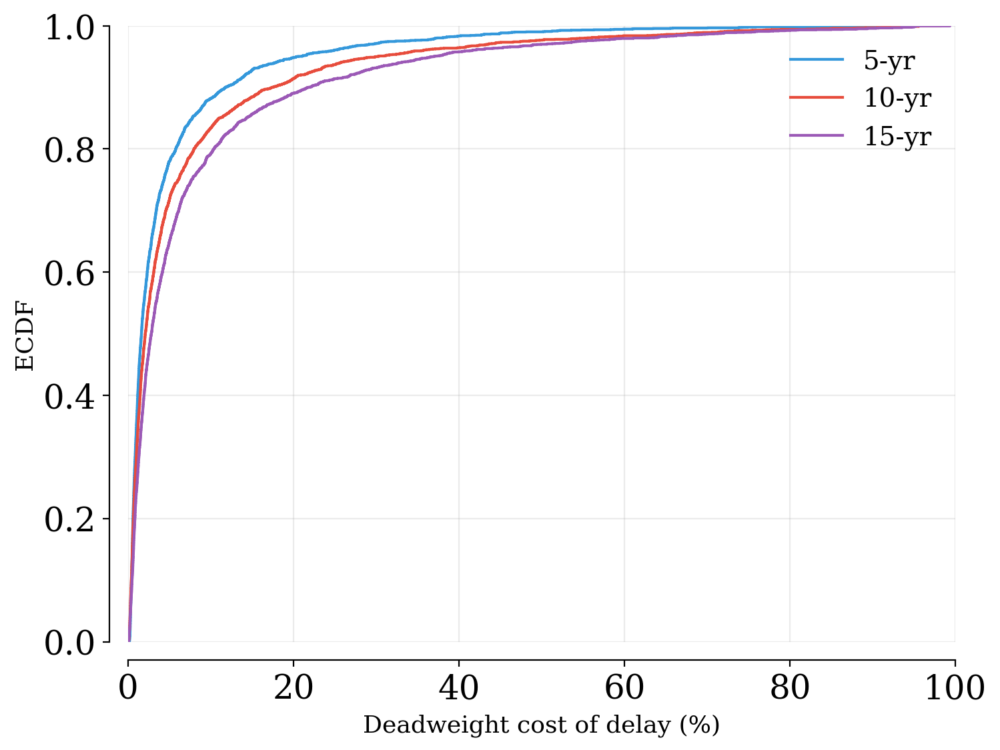

In [ ]:
x_col, y_col, g_col = 'eis', 'delta_c_pct', 'delay_year'
colors = {5: '#3498db', 10: '#e74c3c', 15: '#9b59b6'}
df = conanalysis.loc[(conanalysis[y_col] > 0) & (conanalysis[y_col] <= 100), [y_col, g_col]].copy()

plt.figure(figsize=(8,6))
for delay, sub in df.groupby(g_col):
    sns.ecdfplot(data=sub, x=y_col, label=f'{delay}-yr', color=colors[delay])
plt.xlim(0, 100)
plt.xlabel('Deadweight cost of delay (%)', fontsize=13)
plt.ylabel('ECDF', fontsize=13)
plt.grid(alpha=0.25)
plt.legend(frameon=False)
sns.despine(trim=True, offset=10)
plt.show()


In [ ]:
def plot_dwl_vs_param(data, param_name, dwl_col='deadweight_per_ton', 
                       delay_col='delay_year', figsize=(10, 7), log_scale=True):

    fig, ax = plt.subplots(figsize=figsize)
    
    unique_delays = sorted(data[delay_col].unique())
    

    for delay in unique_delays:
        mask = data[delay_col] == delay
        x = data.loc[mask, param_name].values
        y = data.loc[mask, dwl_col].values
        
        # Filter out non-positive values for log scale
        if log_scale:
            pos_mask = y > 0
            x = x[pos_mask]
            y = y[pos_mask]
        
        # Scatter plot
        ax.scatter(x, y, alpha=0.4, s=20, 
                  color=delay_colors[delay], 
                  label=f'{delay} year delay')
        
        lr = LinearRegression()
        lr.fit(x.reshape(-1, 1), y)
        x_line = np.linspace(x.min(), x.max(), 100)
        y_line = lr.predict(x_line.reshape(-1, 1))
        
        r2 = lr.score(x.reshape(-1, 1), y)
        
        # Plot regression line
        ax.plot(x_line, y_line, color=delay_colors[delay], 
               linewidth=2.5, linestyle='--',
               label=f'{delay}yr: R²={r2:.3f}')
    
    if log_scale:
        ax.set_yscale('log')
        ax.set_ylabel('Deadweight Loss per Ton ($/tCO₂) [Log Scale]', fontsize=14, fontweight='bold')
    else:
        ax.set_ylabel('Deadweight Loss per Ton ($/tCO₂)', fontsize=14, fontweight='bold')
    
    ax.set_xlabel(param_name.upper(), fontsize=14, fontweight='bold')
    ax.set_title(f'Deadweight Loss vs {param_name.upper()} by Delay Period',
                fontsize=16, fontweight='bold', pad=15)
    ax.legend(loc='best', fontsize=10, framealpha=0.9)
    ax.grid(True, alpha=0.3, which='both')
    
    plt.tight_layout()
    #sns.despine(trim=True, offset=10)
    return fig, ax

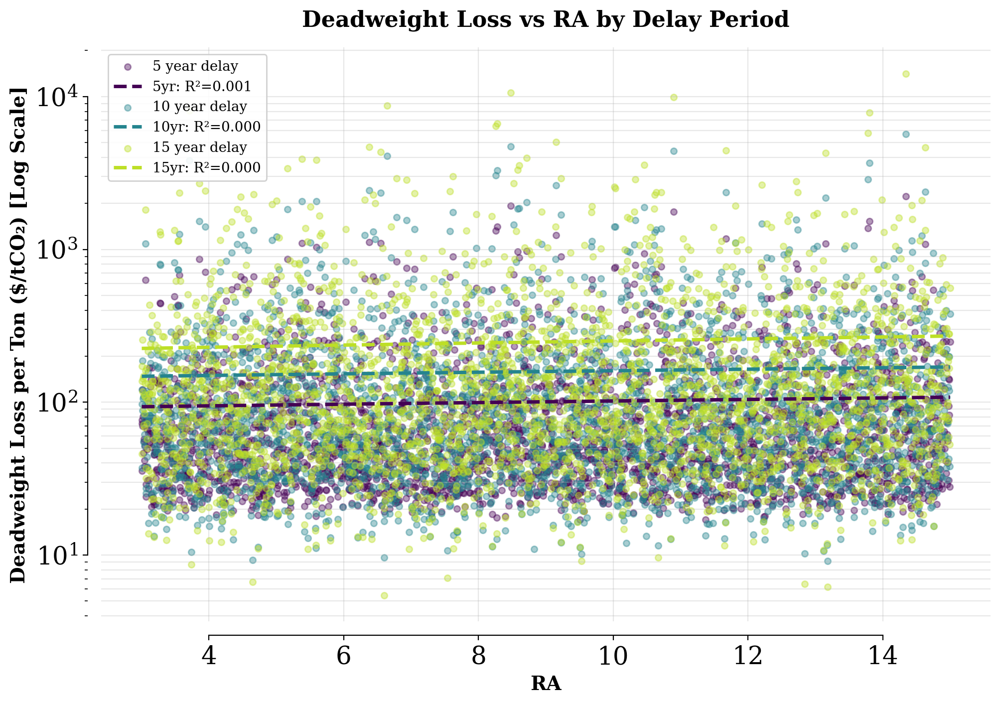

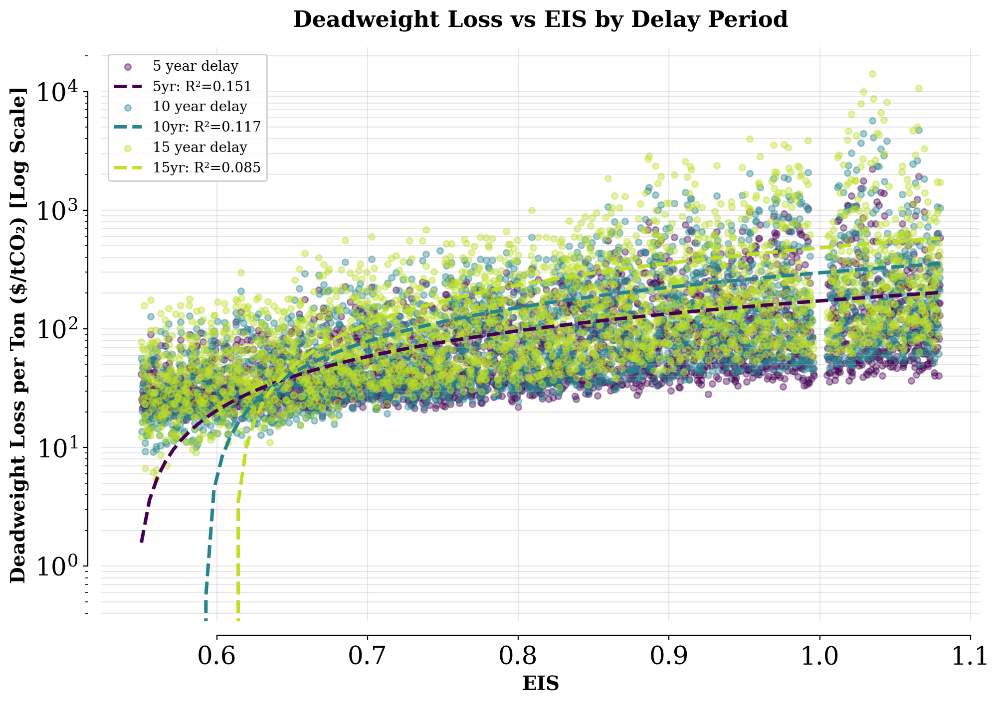

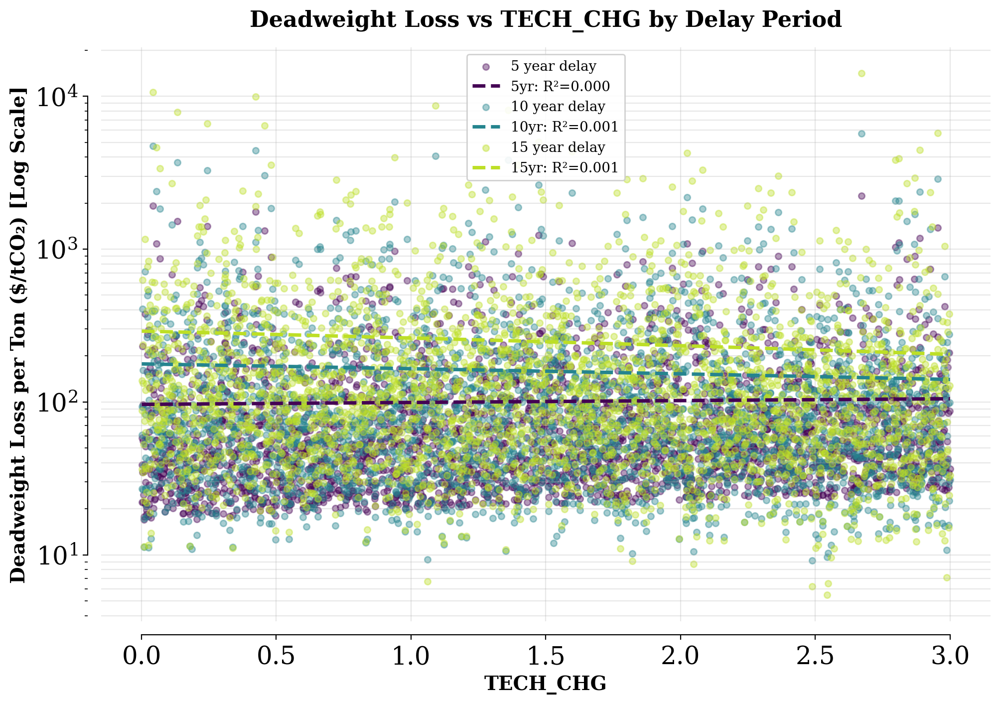

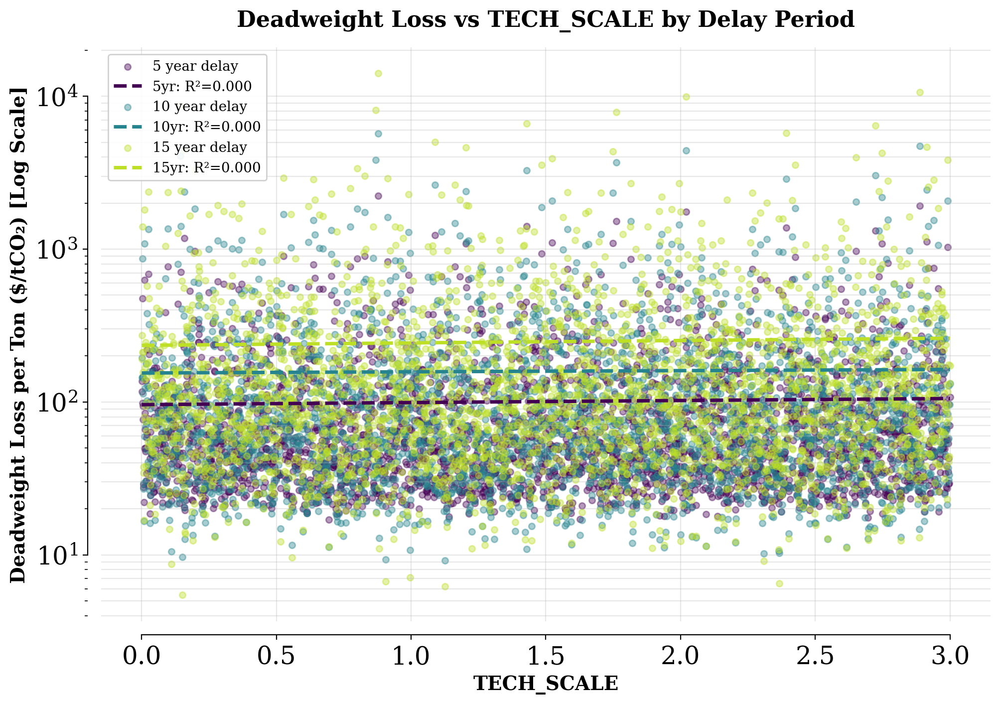

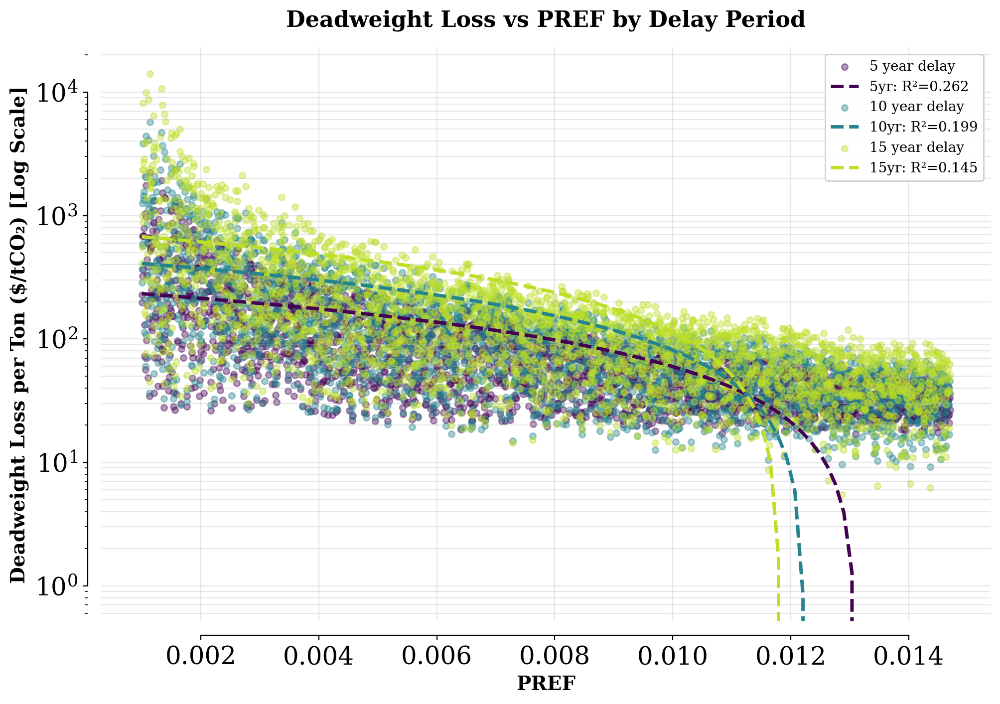

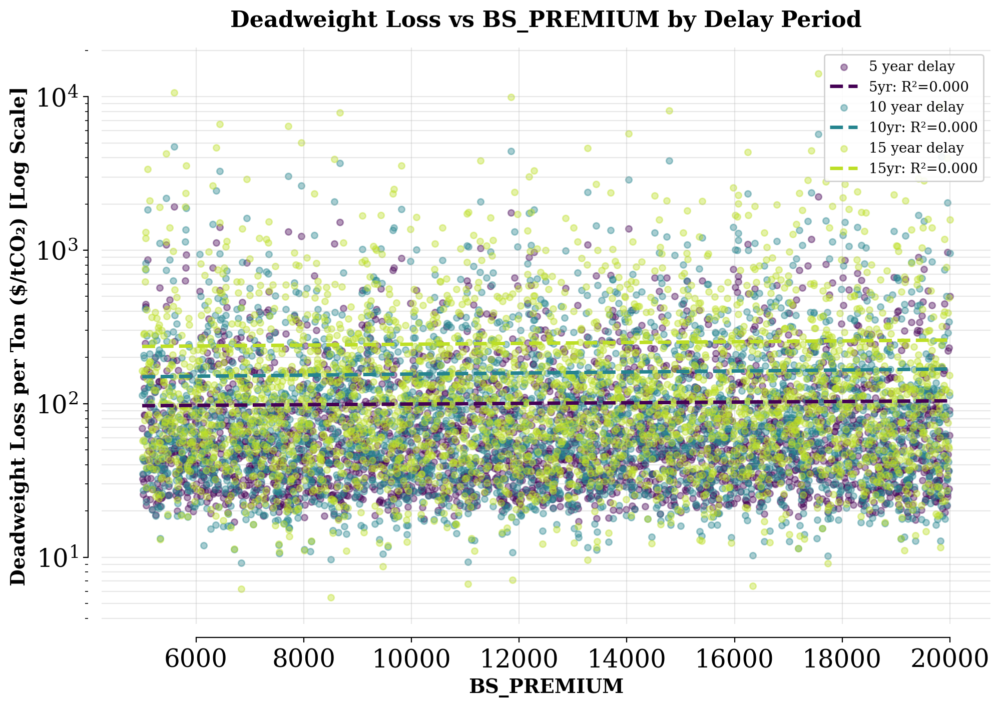

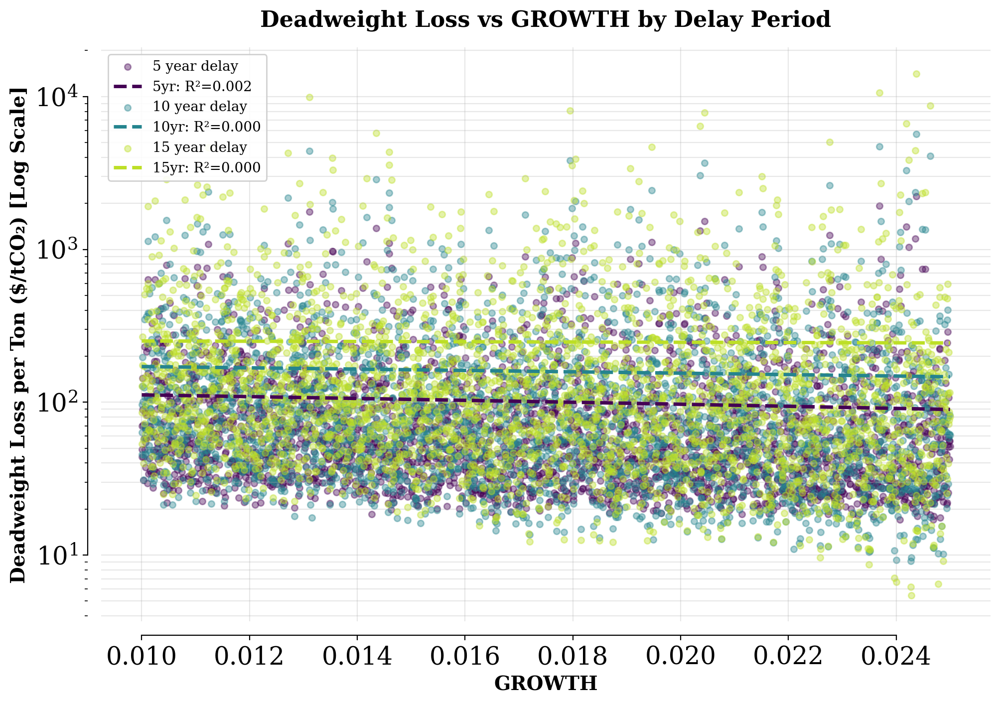

In [15]:
for param in params_of_interest:
    fig, ax = plot_dwl_vs_param(conanalysis, param)
    if save_fig:
        plt.savefig(basefile + f'dwl_vs_{param}_by_delay.png', dpi=300, bbox_inches='tight')
    plt.show()